# Panfetal spleen sorted B experiment 
# 2 Apr 2022 Chenqu

In [91]:
import numpy as np
import scipy as sp
import scanpy as sc
import pandas as pd
from collections import Counter
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import rc
from matplotlib import colors
import seaborn as sb
from itertools import compress
import random
import scirpy as ir

sc.settings.set_figure_params(dpi = 160, color_map = 'RdYlBu_r', dpi_save = 300, format = 'pdf')
plt.rcParams["figure.figsize"] = [6,6]

In [2]:
import rpy2
%load_ext rpy2.ipython

In [3]:
sb.set_palette('tab10')

In [4]:
# import utils (in github folder src/utils/)
import sys
sys.path.append('/home/jovyan/Pan_fetal_immune/src/utils/')
from array_operations import *
from colors import *

In [5]:
organ_order = ['YS','LI','BM','TH','SP','MLN','SK','GU','KI']
organ_name_order = ['Yolk Sac','Liver','Bone Marrow','Thymus','Spleen','Mesenteric Lymph Node','Skin','Gut','Kidney']

In [6]:
# set working directory
%cd /home/jovyan/panfetal/

/home/jovyan/panfetal


In [7]:
# figure directory
fig_path = '/home/jovyan/mount/gdrive/Pan_fetal/plots_output/chenqu_jhub/'
sc.settings.figdir = fig_path

# Load data

In [8]:
adata = sc.read('/nfs/team205/ed6/data/Fetal_immune/sorted_B_cells/sortedBcells_query.scVI.h5ad') # raw counts

/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/anndata/_core/anndata.py:119: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [9]:
adata.var_names_make_unique()

In [10]:
adata.raw = adata.copy()

update manifest

In [11]:
meta = pd.read_csv('/home/jovyan/Pan_fetal_immune/metadata/sorted_B_sample_manifest.csv')

In [12]:
meta

,Donor,organ,Date_of_sample,Sample,FACS_sort,sanger_sample_ID
0,F149,SP,21/09/2021,F149-SPL-0-SC-FACS-1,CCR10high,WSSS_F_Imm11192515
1,F149,SP,21/09/2021,F149-SPL-0-SC-FACS-2,CCR10lowCD27+CD43+,WSSS_F_Imm11192516
2,F149,SP,21/09/2021,F149-SPL-0-SC-FACS-3,CCR10lowCD27-CD43+,WSSS_F_Imm11192517
3,F149,SP,21/09/2021,F149-SPL-0-SC-FACS-4,CCR10lowCD27-CD43-,WSSS_F_Imm11192518


In [13]:
adata.obs['FACS_sort'] = lookup(adata.obs['file'], meta, 'sanger_sample_ID','FACS_sort')

# Annotation prediction with the whole panfetal dataset as training data

In [24]:
import celltypist
from celltypist import models

In [16]:
celltypist.__version__

'0.1.9'

In [17]:
adata_new=adata.copy()
#adata_new.var.index = adata_new.var['gene_names']
sc.pp.normalize_per_cell(adata_new,counts_per_cell_after=1e4,key_n_counts='total_counts')
sc.pp.log1p(adata_new) # adata_new is normalised logged count

In [18]:
adata_new.raw = adata_new.copy()

In [19]:
predictions = celltypist.annotate(adata_new, model = '/lustre/scratch117/cellgen/team205/cx1/Celltypist/pan_fetal/legacy/Pan_Fetal_Human.pkl', majority_voting = True)

🔬 Input data has 29509 cells and 33538 genes
🔗 Matching reference genes in the model
🧬 6971 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 15
🗳️ Majority voting the predictions
✅ Majority voting done!


In [20]:
#adata = predictions.to_adata(insert_conf_by='majority_voting') # so confidence score is for label predicted in majortiy voting
adata_new = predictions.to_adata()

... storing 'FACS_sort' as categorical


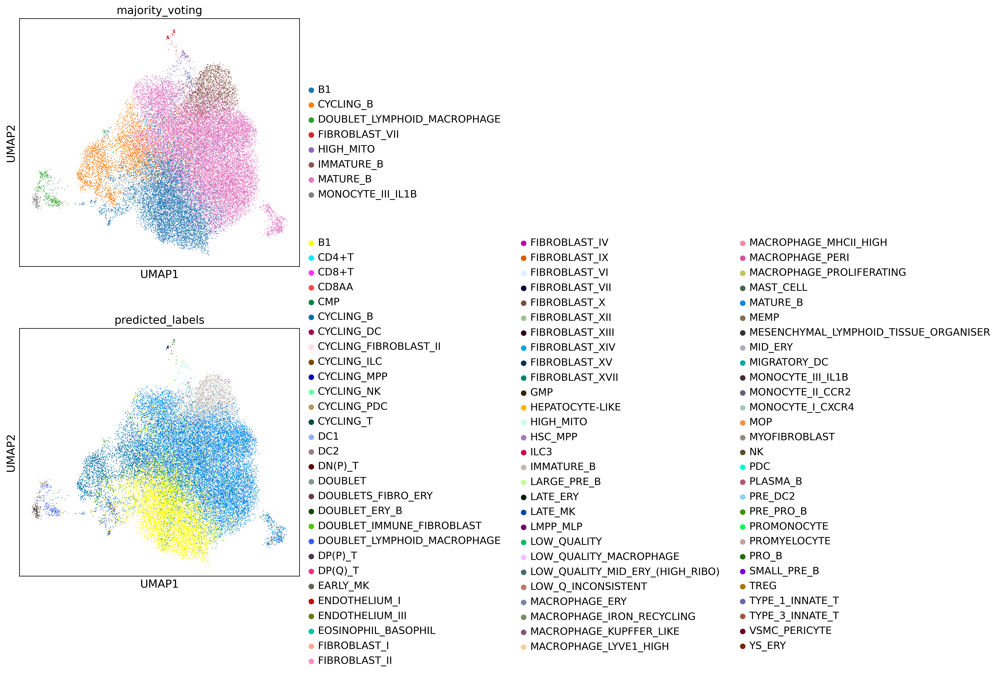

In [21]:
sc.pl.umap(adata_new, color=['majority_voting','predicted_labels'],ncols=1)

In [22]:
#### for non-B predicted clusters, take the annotation from the majority_voting, and conf_score here
adata_new.obs.loc[adata_new.obs['majority_voting'].isin([
 'DOUBLET_LYMPHOID_MACROPHAGE',
 'FIBROBLAST_VII',
 'HIGH_MITO',
 'MONOCYTE_III_IL1B']),'anno'] = adata_new.obs.loc[adata_new.obs['majority_voting'].isin([
 'DOUBLET_LYMPHOID_MACROPHAGE',
 'FIBROBLAST_VII',
 'HIGH_MITO',
 'MONOCYTE_III_IL1B']),'majority_voting'] 
adata_new.obs.loc[adata_new.obs['majority_voting'].isin([
 'DOUBLET_LYMPHOID_MACROPHAGE',
 'FIBROBLAST_VII',
 'HIGH_MITO',
 'MONOCYTE_III_IL1B']),'combined_conf_score'] = adata_new.obs.loc[adata_new.obs['majority_voting'].isin([
 'DOUBLET_LYMPHOID_MACROPHAGE',
 'FIBROBLAST_VII',
 'HIGH_MITO',
 'MONOCYTE_III_IL1B']),'conf_score'] 

... storing 'anno' as categorical


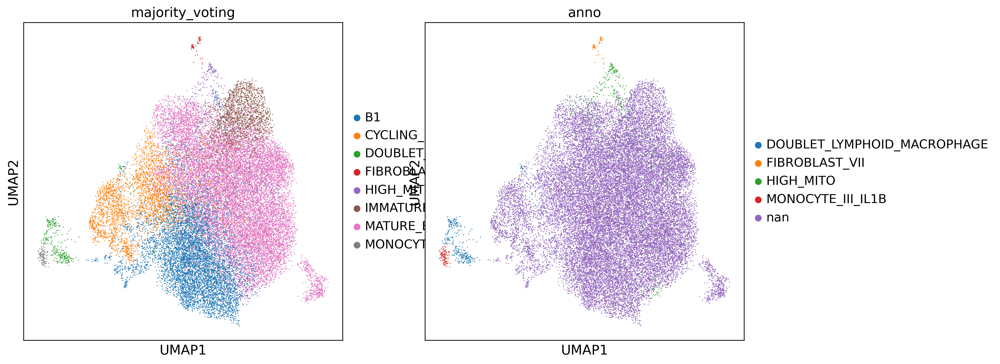

In [23]:
sc.pl.umap(adata_new, color=['majority_voting','anno'])

### B cells - redo celltypist with panfetal non-cycling mature B cells as training dataset (so that cycling B cells are predicted to be B1 or Mature B)

In [25]:
# model saved from B1_scVI_paper_figure_updated.ipynb
predictions = celltypist.annotate(adata_new, model = 'panfetal_B_celltypist.pkl', majority_voting = True)

🔬 Input data has 29509 cells and 33538 genes
🔗 Matching reference genes in the model
🧬 848 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 15
🗳️ Majority voting the predictions
✅ Majority voting done!


In [21]:
panfetal = sc.read('/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.20210429.LYMPHOID.embedding.h5ad')

Only considering the two last: ['.embedding', '.h5ad'].
Only considering the two last: ['.embedding', '.h5ad'].


In [22]:
panfetal.raw = panfetal.copy()

In [23]:
obs = pd.read_csv('/nfs/team205/ed6/data/Fetal_immune/PAN.A01.v01.entire_data_normalised_log.20210429.full_obs.annotated.clean.csv', index_col = 0) # final annotations and removed maternal contaminant cells

/home/jovyan/my-conda-envs/skeleton/lib/python3.8/site-packages/IPython/core/interactiveshell.py:3146: DtypeWarning: Columns (6) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [24]:
for col in obs:
    panfetal.obs[col] = obs[col] # use anno_lvl_2_final_clean

In [25]:
B = panfetal[panfetal.obs['anno_lvl_2_final_clean'].isin(['IMMATURE_B','MATURE_B','B1','PLASMA_B'])]

In [32]:
tmp = B.X.copy()
tmp = np.expm1(tmp) # inverse log1p
B.X = tmp.copy()

In [35]:
sc.pp.normalize_per_cell(B,counts_per_cell_after=1e4,key_n_counts='total_counts')
sc.pp.log1p(B)

In [37]:
# remove cycling genes 
cc_genes = [x.strip() for x in open('/home/jovyan/gene_list/cc_genes.txt')]

In [38]:
B_nocc = B[:,~(B.var_names.isin(cc_genes))].copy()
B_nocc.raw = B_nocc.copy()

In [39]:
model = celltypist.train(B_nocc, 'anno_lvl_2_final_clean', check_expression = False, n_jobs = 10, feature_selection = True)

🍳 Preparing data before training
✂️ 10125 non-expressed genes are filtered out
⚖️ Scaling input data
🏋️ Training data using SGD logistic regression
🔎 Selecting features
🧬 850 features are selected
🏋️ Starting the second round of training
🏋️ Training data using logistic regression
✅ Model training done!


In [41]:
model.write('sorted B cells/panfetal_B_celltypist.pkl')

In [21]:
predictions = celltypist.annotate(adata_new, model = 'sorted B cells/panfetal_B_celltypist.pkl', majority_voting = True)

🔬 Input data has 29509 cells and 33538 genes
🔗 Matching reference genes in the model
🧬 850 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 15
🗳️ Majority voting the predictions
✅ Majority voting done!


In [26]:
#adata = predictions.to_adata(prefix='panfetal_B_model_',insert_conf_by='majority_voting')
adata_new = predictions.to_adata(prefix='panfetal_B_model_')

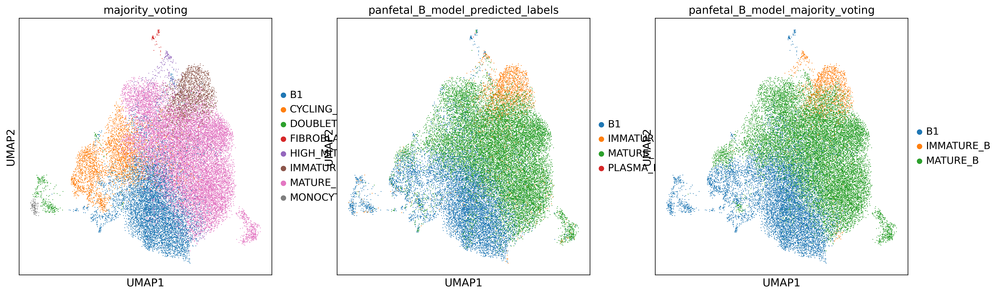

In [27]:
sc.pl.umap(adata_new,color=['majority_voting','panfetal_B_model_predicted_labels','panfetal_B_model_majority_voting'])

In [28]:
#### for predicted B cells, take the predicted annotation from the this model here (to avoid cycling B cells)
adata_new.obs['anno'] = adata_new.obs['anno'].astype('str')
adata_new.obs.loc[~(adata_new.obs['majority_voting'].isin([
 'DOUBLET_LYMPHOID_MACROPHAGE',
 'FIBROBLAST_VII',
 'HIGH_MITO',
 'MONOCYTE_III_IL1B'])),'anno'] = adata_new.obs.loc[~(adata_new.obs['majority_voting'].isin([
 'DOUBLET_LYMPHOID_MACROPHAGE',
 'FIBROBLAST_VII',
 'HIGH_MITO',
 'MONOCYTE_III_IL1B'])),'panfetal_B_model_majority_voting']
adata_new.obs.loc[~(adata_new.obs['majority_voting'].isin([
 'DOUBLET_LYMPHOID_MACROPHAGE',
 'FIBROBLAST_VII',
 'HIGH_MITO',
 'MONOCYTE_III_IL1B'])),'combined_conf_score'] = adata_new.obs.loc[~(adata_new.obs['majority_voting'].isin([
 'DOUBLET_LYMPHOID_MACROPHAGE',
 'FIBROBLAST_VII',
 'HIGH_MITO',
 'MONOCYTE_III_IL1B'])),'panfetal_B_model_conf_score']

... storing 'anno' as categorical


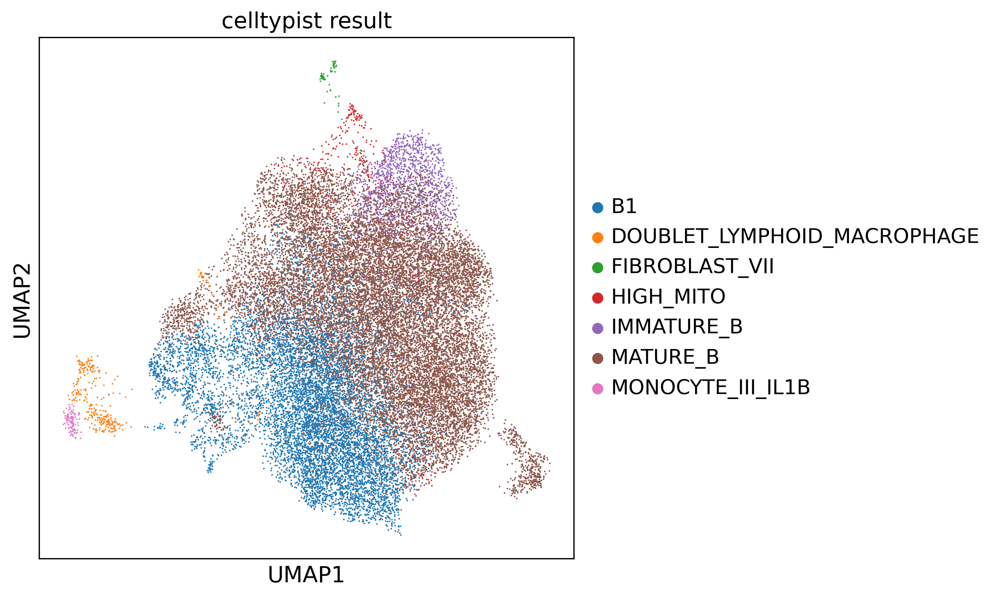

In [29]:
# so in updated anno - non-B (majority voting with overall panfetal results) Bcell - majority voting with panfetal noncycling mature B as training dataset
plt.rcParams["figure.figsize"] = [6,6]
sc.pl.umap(adata_new, color=['anno'],legend_loc='right margin', title='celltypist result',save='sorted_B_celltypist.png')

In [30]:
adata_new.write_h5ad('write/sorted_B_scVI_predictions.h5ad')

# Calculate ct percentage bars

In [69]:
cluster_counter = pd.DataFrame(columns =['B1','MATURE_B','IMMATURE_B','MONOCYTE_III_IL1B','FIBROBLAST_VII','DOUBLET_LYMPHOID_MACROPHAGE','HIGH_MITO',], 
                               index = list(adata_new.obs['FACS_sort'].cat.categories),dtype='int')

In [70]:
for i in range(cluster_counter.columns.shape[0]):
    annot = cluster_counter.columns[i]
    
    for j in range(cluster_counter.index.shape[0]):
        file = cluster_counter.index[j]
        counter = Counter(adata_new.obs.loc[(adata_new.obs['FACS_sort']== file), 'anno'])
        
        cluster_counter.iloc[j][annot] = counter[annot] 

In [71]:
cluster_counter

,B1,MATURE_B,IMMATURE_B,MONOCYTE_III_IL1B,FIBROBLAST_VII,DOUBLET_LYMPHOID_MACROPHAGE,HIGH_MITO
CCR10high,3543.0,4533.0,387.0,44.0,32.0,172.0,88.0
CCR10lowCD27+CD43+,3845.0,3821.0,589.0,49.0,14.0,117.0,83.0
CCR10lowCD27-CD43+,1508.0,4526.0,414.0,7.0,6.0,12.0,111.0
CCR10lowCD27-CD43-,169.0,5305.0,3.0,0.0,2.0,3.0,126.0


In [72]:
cluster_counter_percentage = cluster_counter.copy()

In [73]:
for i in range(cluster_counter_percentage.shape[0]):
    cluster_counter_percentage.iloc[i] = cluster_counter_percentage.iloc[i] / pd.DataFrame.sum(cluster_counter_percentage,axis=1).iloc[i] * 100

In [74]:
cluster_counter_percentage # this is the percentage of each cell type in each sample

,B1,MATURE_B,IMMATURE_B,MONOCYTE_III_IL1B,FIBROBLAST_VII,DOUBLET_LYMPHOID_MACROPHAGE,HIGH_MITO
CCR10high,40.265939,51.517218,4.398227,0.500057,0.363678,1.954768,1.000114
CCR10lowCD27+CD43+,45.139704,44.857948,6.914769,0.575252,0.164358,1.373562,0.974407
CCR10lowCD27-CD43+,22.904010,68.742406,6.287971,0.106318,0.091130,0.182260,1.685905
CCR10lowCD27-CD43-,3.013552,94.597004,0.053495,0.000000,0.035663,0.053495,2.246790


#### plot cell cluster percentage

In [75]:
df = cluster_counter_percentage
df['FACS_sort']=df.index

In [76]:
# adjust the color order so as to follow the same color pattern in Fig 4A
celltypes = ['IMMATURE_B','MATURE_B','B1','MONOCYTE_III_IL1B','FIBROBLAST_VII','DOUBLET_LYMPHOID_MACROPHAGE','HIGH_MITO',]
ct_color_map = dict(zip(celltypes, np.array(sb.color_palette('tab10'))[range(len(celltypes))]))

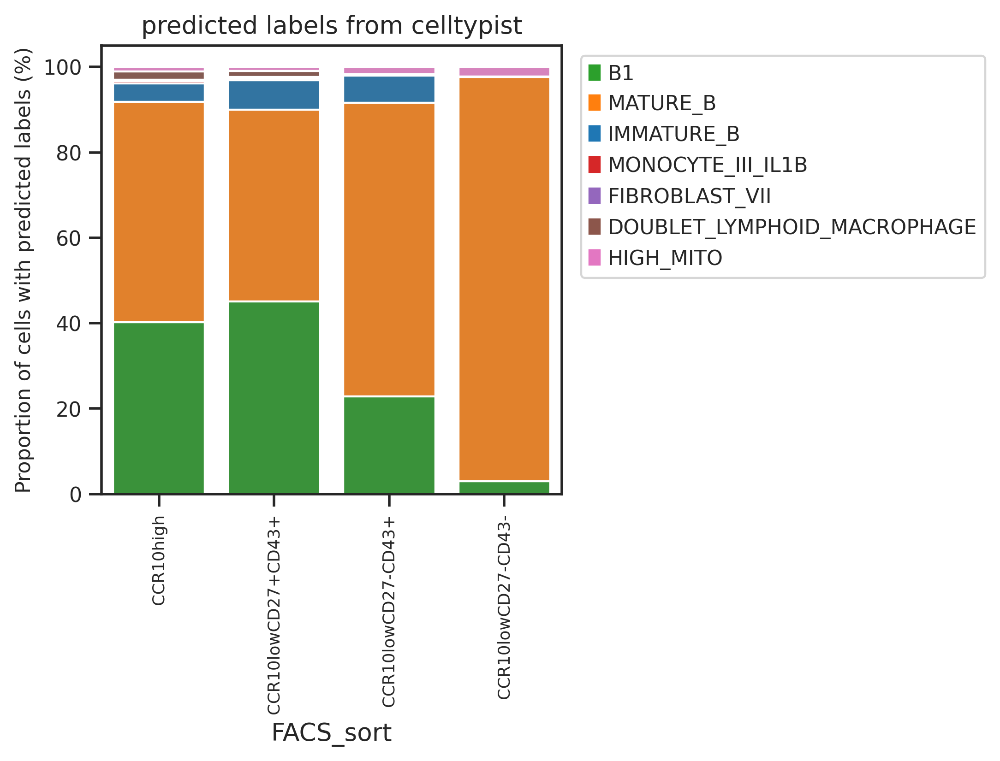

In [90]:
import matplotlib.patches as mpatches
sb.set_theme(style='ticks')
#sb.set_theme(style="white")
color =sb.color_palette('tab10')
plt.figure(figsize=(4, 4))

legend = []

for i in range(df.shape[1]-1)[::-1]:
    ct = df.columns[i]
    bar = sb.barplot(x='FACS_sort',  y=np.sum(df.iloc[:,0:i+1],axis=1), data=df, color=ct_color_map[ct])
    legend = legend+[mpatches.Patch(color=ct_color_map[ct], label=df.columns[i])]
plt.xticks(fontsize=8,rotation=90)
plt.yticks(fontsize=10)
plt.title('predicted labels from celltypist')
plt.ylabel('Proportion of cells with predicted labels (%)', fontsize=10)

# add legend
plt.legend(handles=legend[::-1],bbox_to_anchor=(1.02, 1), loc='upper left', fontsize='small')

plt.savefig(fig_path+'sorted_B_celltypist.pdf',bbox_inches='tight');

# Marker gene plot

In [17]:
#sc.tl.leiden(adata_new, resolution = 1)

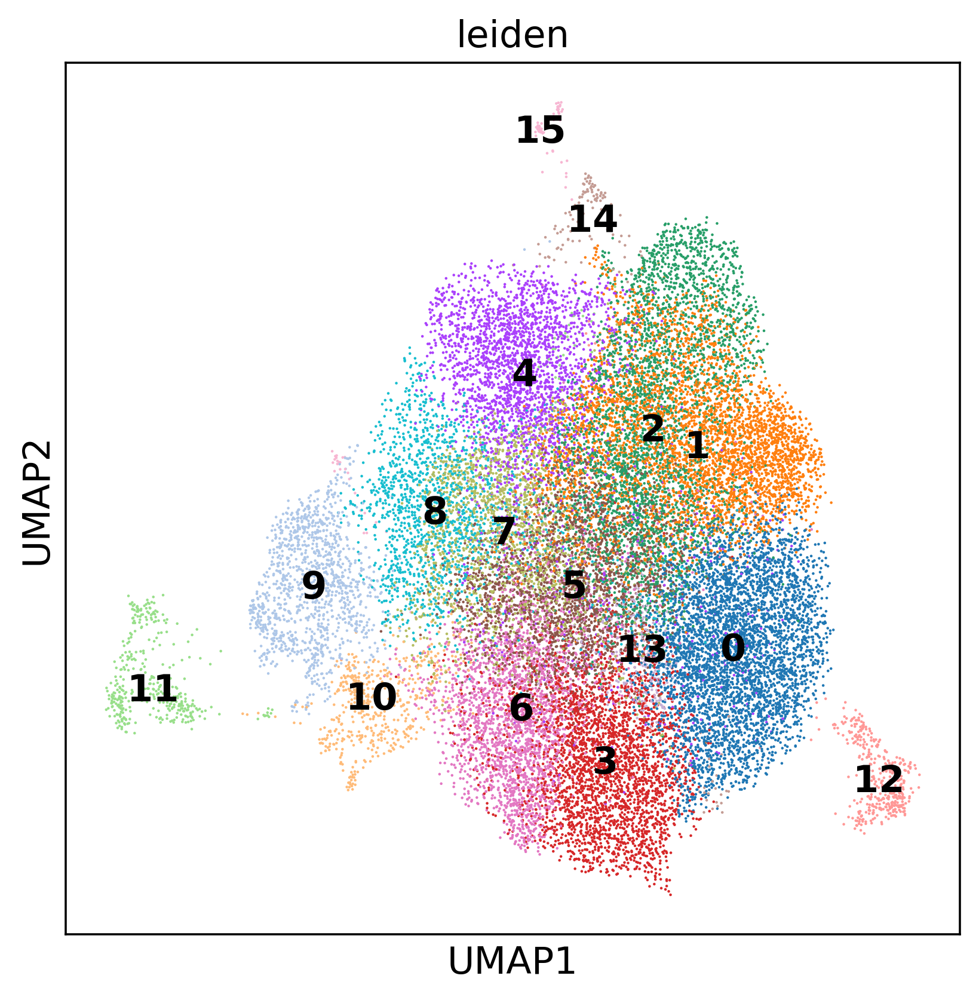

In [18]:
#sc.pl.umap(adata_new, color=['leiden'],legend_loc='on data')

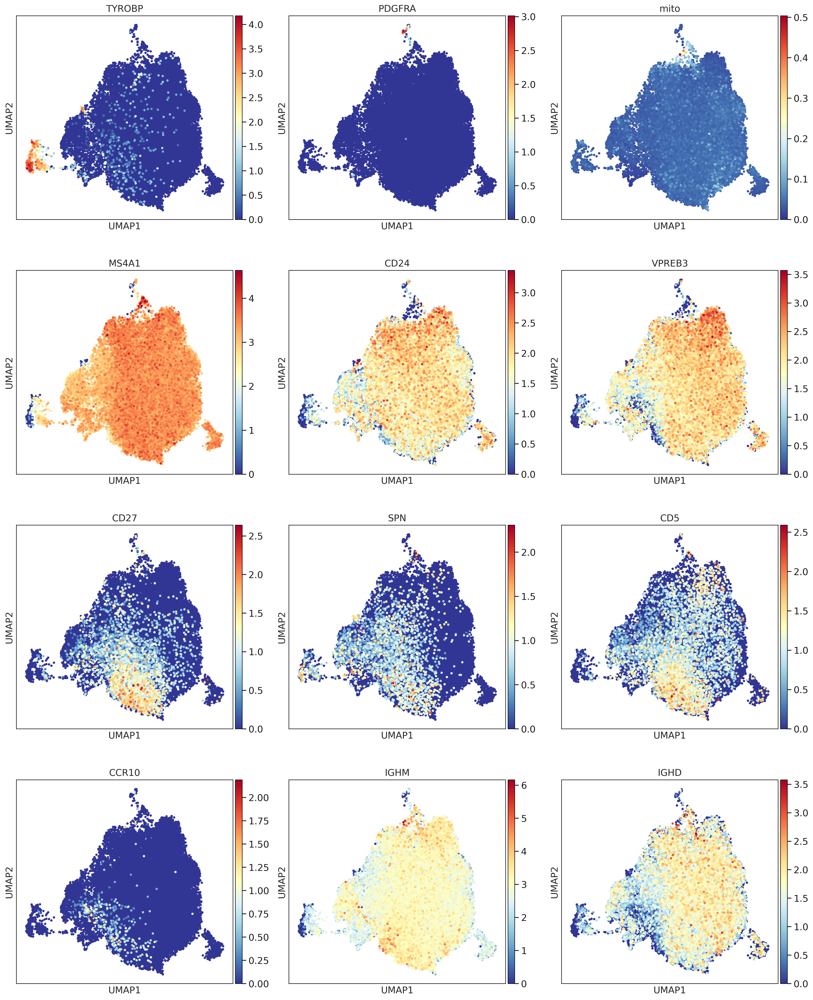

In [92]:
genes = ['TYROBP','PDGFRA','mito',
        'MS4A1','CD24','VPREB3',
         'CD27','SPN','CD5','CCR10',
         'IGHM','IGHD',]
sc.pl.umap(adata_new, color =genes, ncols=3,size=50,save='sorted_B_markers.png')

In [88]:
sc.tl.embedding_density(adata_new, basis='umap', groupby='FACS_sort')

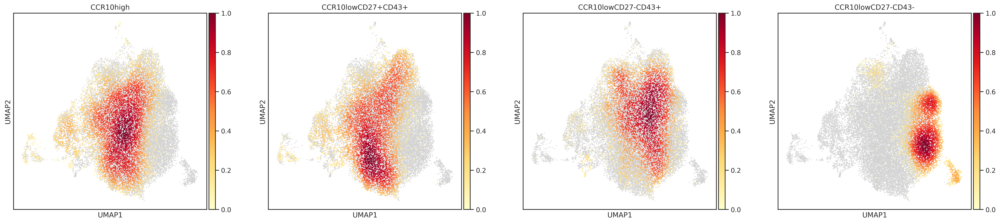

In [89]:
#plt.rcParams["figure.figsize"] = [3,3]
sc.pl.embedding_density(adata_new,basis='umap', ncols=10,key='umap_density_FACS_sort',fg_dotsize =10,bg_dotsize=10,frameon=True,wspace=0.2,save='sorted_B_density.png')